In [ ]:
pip install --upgrade keras

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 22.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 311.2/311.2 kB 37.4 MB/s eta 0:00:00
  Attempting uninstall: keras
    Found existing installation: keras 2.15.0
    Uninstalling keras-2.15.0:
      Successfully uninstalled keras-2.15.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tensorflow 2.15.0 requires keras<2.16,>=2.15.0, but you have keras 3.3.2 which is incompatible.


In [ ]:
import keras
from keras import layers
from keras import ops


import os
import numpy as np
from glob import glob
import cv2
from scipy.io import loadmat
import matplotlib.pyplot as plt
import tensorflow as tf
from keras.callbacks import ModelCheckpoint, ReduceLROnPlateau, EarlyStopping
# For data preprocessing
from tensorflow import image as tf_image
from tensorflow import data as tf_data
from tensorflow import io as tf_io
from keras.utils import plot_model

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
from PIL import Image
image_path="/content/drive/MyDrive/Dataset/maskfinal/044.png"
from PIL import Image
import numpy as np

def analyze_image(image_path):
  """
  This function reads an image, converts it to grayscale, converts it to a NumPy array,
  and prints the number of occurrences of each unique pixel value.

  Args:
      image_path (str): Path to the image file.
  """
  try:
    # Open the image in grayscale mode
    img = Image.open(image_path).convert('L')
  except FileNotFoundError:
    print(f"Error: Image file not found at {image_path}")
    return

  # Convert the image data to a NumPy array
  image_array = np.array(img)

  # Find the unique values and their counts
  unique_values, counts = np.unique(image_array, return_counts=True)

  # Print the results
  print("Unique pixel values and their occurrences:")
  for value, count in zip(unique_values, counts):
    print(f"Value {value}: {count} occurrences")


analyze_image(image_path)



Unique pixel values and their occurrences:
Value 0: 457222 occurrences
Value 1: 33749 occurrences
Value 2: 108918 occurrences
Value 3: 111 occurrences


In [ ]:
IMAGE_SIZE = 720
BATCH_SIZE = 4
NUM_CLASSES = 20
DATA_DIR = "/content/drive/MyDrive/Dataset"
NUM_TRAIN_IMAGES = 170
NUM_VAL_IMAGES = 35

train_images = sorted(glob(os.path.join(DATA_DIR, "imgfinal/*")))[:NUM_TRAIN_IMAGES]
train_masks = sorted(glob(os.path.join(DATA_DIR, "maskfinal/*")))[:NUM_TRAIN_IMAGES]
val_images = sorted(glob(os.path.join(DATA_DIR, "imgfinal/*")))[:NUM_VAL_IMAGES]
val_masks = sorted(glob(os.path.join(DATA_DIR, "maskfinal/*")))[:NUM_VAL_IMAGES]


def read_image(image_path, mask=False):
    image = tf_io.read_file(image_path)
    if mask:
        image = tf_image.decode_png(image, channels=1)
        image.set_shape([None, None, 1])
        image = tf_image.resize(images=image, size=[IMAGE_SIZE, IMAGE_SIZE])
    else:
        image = tf_image.decode_png(image, channels=3)
        image.set_shape([None, None, 3])
        image = tf_image.resize(images=image, size=[IMAGE_SIZE, IMAGE_SIZE])
    return image


def load_data(image_list, mask_list):
    image = read_image(image_list)
    mask = read_image(mask_list, mask=True)
    return image, mask


def data_generator(image_list, mask_list):
    dataset = tf_data.Dataset.from_tensor_slices((image_list, mask_list))
    dataset = dataset.map(load_data, num_parallel_calls=tf_data.AUTOTUNE)
    dataset = dataset.batch(BATCH_SIZE, drop_remainder=True)
    return dataset


train_dataset = data_generator(train_images, train_masks)
val_dataset = data_generator(val_images, val_masks)

print("Train Dataset:", train_dataset)
print("Val Dataset:", val_dataset)

Train Dataset: <_BatchDataset element_spec=(TensorSpec(shape=(4, 720, 720, 3), dtype=tf.float32, name=None), TensorSpec(shape=(4, 720, 720, 1), dtype=tf.float32, name=None))>
Val Dataset: <_BatchDataset element_spec=(TensorSpec(shape=(4, 720, 720, 3), dtype=tf.float32, name=None), TensorSpec(shape=(4, 720, 720, 1), dtype=tf.float32, name=None))>


In [ ]:
# IMAGE_SIZE = 512
# BATCH_SIZE = 4
# NUM_CLASSES = 3
# DATA_DIR = "/content/drive/MyDrive/Dataset"
# NUM_TRAIN_IMAGES = 80
# NUM_VAL_IMAGES = 20

# train_images = sorted(glob(os.path.join(DATA_DIR, "img/*")))[:NUM_TRAIN_IMAGES]
# train_masks = sorted(glob(os.path.join(DATA_DIR, "mask/*")))[:NUM_TRAIN_IMAGES]
# val_images = sorted(glob(os.path.join(DATA_DIR, "img/*")))[
#     NUM_TRAIN_IMAGES : NUM_VAL_IMAGES + NUM_TRAIN_IMAGES
# ]
# val_masks = sorted(glob(os.path.join(DATA_DIR, "mask/*")))[
#     NUM_TRAIN_IMAGES : NUM_VAL_IMAGES + NUM_TRAIN_IMAGES
# ]


# def read_image(image_path, mask=False):
#     image = tf_io.read_file(image_path)
#     if mask:
#         # Decode as RGB for segmentation masks
#         image = tf_image.decode_png(image, channels=3)
#         # Convert to float32 for potential normalization
#         image = tf.cast(image, tf.float32)
#         # Normalize pixel values to range [0, 1] (optional)
#         image = image / 255.0
#         image.set_shape([None, None, 3])
#         # Resize to desired size
#         image = tf_image.resize(images=image, size=[IMAGE_SIZE, IMAGE_SIZE])
#     else:
#         # Existing logic for reading images (no changes needed)
#         image = tf_image.decode_png(image, channels=3)
#         image.set_shape([None, None, 3])
#         image = tf_image.resize(images=image, size=[IMAGE_SIZE, IMAGE_SIZE])
#     return image

# def load_data(image_list, mask_list):
#     image = read_image(image_list)
#     mask = read_image(mask_list, mask=True)
#     return image, mask


# def data_generator(image_list, mask_list):
#     dataset = tf_data.Dataset.from_tensor_slices((image_list, mask_list))
#     dataset = dataset.map(load_data, num_parallel_calls=tf_data.AUTOTUNE)
#     dataset = dataset.batch(BATCH_SIZE, drop_remainder=True)
#     return dataset


# train_dataset = data_generator(train_images, train_masks)
# val_dataset = data_generator(val_images, val_masks)

# print("Train Dataset:", train_dataset)
# print("Val Dataset:", val_dataset)

In [ ]:
def convolution_block(
    block_input,
    num_filters=256,
    kernel_size=3,
    dilation_rate=1,
    use_bias=False,
):
    x = layers.Conv2D(
        num_filters,
        kernel_size=kernel_size,
        dilation_rate=dilation_rate,
        padding="same",
        use_bias=use_bias,
        kernel_initializer=keras.initializers.HeNormal(),
    )(block_input)
    x = layers.BatchNormalization()(x)
    return ops.nn.relu(x)


def DilatedSpatialPyramidPooling(dspp_input):
    dims = dspp_input.shape
    x = layers.AveragePooling2D(pool_size=(dims[-3], dims[-2]))(dspp_input)
    x = convolution_block(x, kernel_size=1, use_bias=True)
    out_pool = layers.UpSampling2D(
        size=(dims[-3] // x.shape[1], dims[-2] // x.shape[2]),
        interpolation="bilinear",
    )(x)

    out_1 = convolution_block(dspp_input, kernel_size=1, dilation_rate=1)
    out_6 = convolution_block(dspp_input, kernel_size=3, dilation_rate=6)
    out_12 = convolution_block(dspp_input, kernel_size=3, dilation_rate=12)
    out_18 = convolution_block(dspp_input, kernel_size=3, dilation_rate=18)

    x = layers.Concatenate(axis=-1)([out_pool, out_1, out_6, out_12, out_18])
    output = convolution_block(x, kernel_size=1)
    return output

In [ ]:
def DeeplabV3Plus(image_size, num_classes):
    model_input = keras.Input(shape=(image_size, image_size, 3))
    preprocessed = keras.applications.resnet50.preprocess_input(model_input)
    resnet50 = keras.applications.ResNet50(
        weights="imagenet", include_top=False, input_tensor=preprocessed
    )
    x = resnet50.get_layer("conv4_block6_2_relu").output
    x = DilatedSpatialPyramidPooling(x)

    input_a = layers.UpSampling2D(
        size=(image_size // 4 // x.shape[1], image_size // 4 // x.shape[2]),
        interpolation="bilinear",
    )(x)
    input_b = resnet50.get_layer("conv2_block3_2_relu").output
    input_b = convolution_block(input_b, num_filters=48, kernel_size=1)

    x = layers.Concatenate(axis=-1)([input_a, input_b])
    x = convolution_block(x)
    x = convolution_block(x)
    x = layers.UpSampling2D(
        size=(image_size // x.shape[1], image_size // x.shape[2]),
        interpolation="bilinear",
    )(x)
    model_output = layers.Conv2D(num_classes, kernel_size=(1, 1), padding="same")(x)
    return keras.Model(inputs=model_input, outputs=model_output)


model = DeeplabV3Plus(image_size=IMAGE_SIZE, num_classes=20)
model.summary()

94765736/94765736 ━━━━━━━━━━━━━━━━━━━━ 5s 0us/step


Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 720, 720, 3)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ get_item (GetItem)        │ (None, 720, 720)       │              0 │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ get_item_1 (GetItem)      │ (None, 720, 720)       │              0 │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ get_item_2 (GetItem)      │ (None, 720, 720)       │              0 │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ stack (Stack)             │ (None, 720, 720, 3)    │              0 │ get_item[0][0],        │
│                           │                        │                │ get_item_1[0][0],      │
│                           │                        │                │ get_item_2[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ add (Add)                 │ (None, 720, 720, 3)    │              0 │ stack[0][0]            │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_pad (ZeroPadding2D) │ (None, 726, 726, 3)    │              0 │ add[0][0]              │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_conv (Conv2D)       │ (None, 360, 360, 64)   │          9,472 │ conv1_pad[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_bn                  │ (None, 360, 360, 64)   │            256 │ conv1_conv[0][0]       │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_relu (Activation)   │ (None, 360, 360, 64)   │              0 │ conv1_bn[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1_pad (ZeroPadding2D) │ (None, 362, 362, 64)   │              0 │ conv1_relu[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1_pool (MaxPooling2D) │ (None, 180, 180, 64)   │              0 │ pool1_pad[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_conv       │ (None, 180, 180, 64)   │          4,160 │ pool1_pool[0][0]       │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_bn         │ (None, 180, 180, 64)   │            256 │ conv2_block1_1_conv[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_relu       │ (None, 180, 180, 64)   │              0 │ conv2_block1_1_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_conv       │ (None, 180, 180, 64)   │         36,928 │ conv2_block1_1_relu[0… │
│ (Conv2D)                  │                        │                │                        │
├──────────────────────

 Total params: 11,857,236 (45.23 MB)

 Trainable params: 11,824,500 (45.11 MB)

 Non-trainable params: 32,736 (127.88 KB)

Epoch 1/50
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.6966 - loss: 1.4027
Epoch 1: val_loss improved from inf to 250.37312, saving model to /content/drive/MyDrive/Dataset/dummy.keras
42/42 ━━━━━━━━━━━━━━━━━━━━ 179s 3s/step - accuracy: 0.6984 - loss: 1.3922 - val_accuracy: 0.1296 - val_loss: 250.3731
Epoch 2/50
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 898ms/step - accuracy: 0.8078 - loss: 0.6219
Epoch 2: val_loss improved from 250.37312 to 140.58900, saving model to /content/drive/MyDrive/Dataset/dummy.keras
42/42 ━━━━━━━━━━━━━━━━━━━━ 44s 1s/step - accuracy: 0.8077 - loss: 0.6220 - val_accuracy: 0.3964 - val_loss: 140.5890
Epoch 3/50
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 886ms/step - accuracy: 0.8077 - loss: 0.6025
Epoch 3: val_loss improved from 140.58900 to 2.13456, saving model to /content/drive/MyDrive/Dataset/dummy.keras
42/42 ━━━━━━━━━━━━━━━━━━━━ 82s 1s/step - accuracy: 0.8076 - loss: 0.6026 - val_accuracy: 0.7730 - val_loss: 2.1346
Epoch 4/50
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 889ms/step - accu

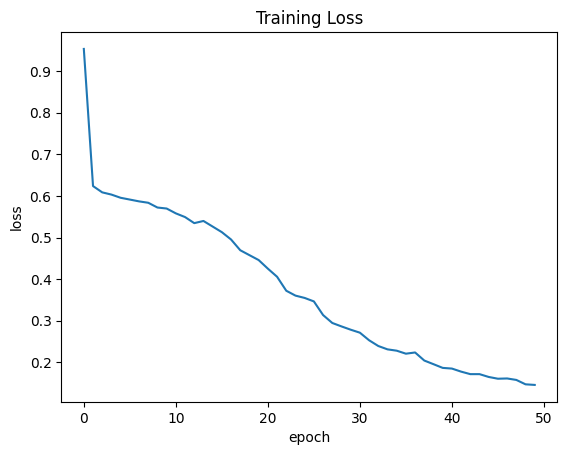

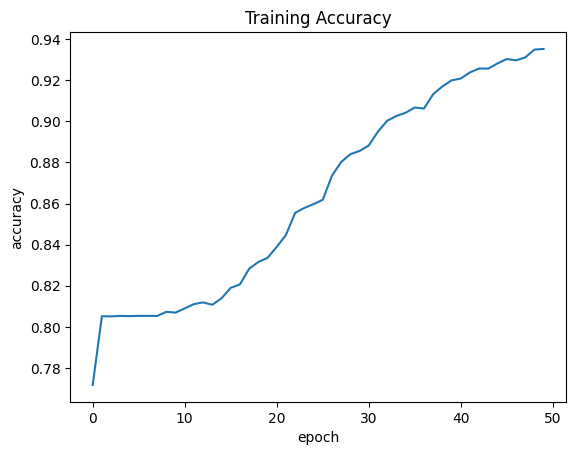

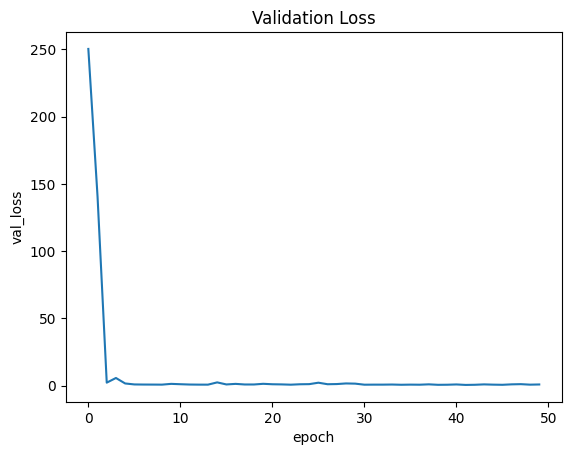

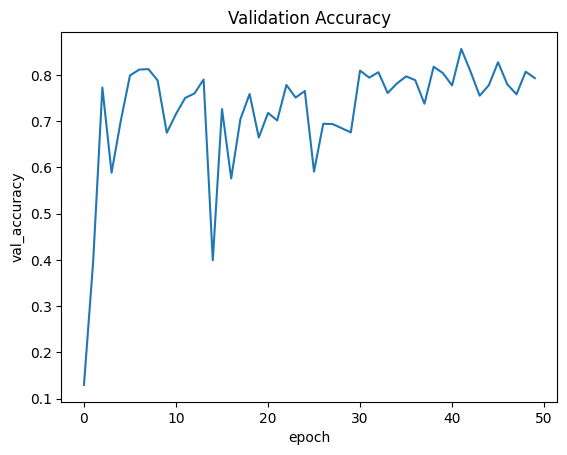

In [ ]:
loss = keras.losses.SparseCategoricalCrossentropy(from_logits=True)
model.compile(
    optimizer=keras.optimizers.Adam(learning_rate=0.001),
    loss=loss,
    metrics=["accuracy"],
)
callbacks = [
            ModelCheckpoint("/content/drive/MyDrive/Dataset/dummy.keras", verbose=1, save_best_only=True, save_weights_only=False,),
            # ReduceLROnPlateau(monitor="val_loss", patience=3, factor=0.1, verbose=1, min_lr=1e-9),
            # EarlyStopping(monitor="val_loss", patience=5, verbose=1)
    ]


history = model.fit(train_dataset, validation_data=val_dataset, epochs=50, callbacks=callbacks)

plt.plot(history.history["loss"])
plt.title("Training Loss")
plt.ylabel("loss")
plt.xlabel("epoch")
plt.show()

plt.plot(history.history["accuracy"])
plt.title("Training Accuracy")
plt.ylabel("accuracy")
plt.xlabel("epoch")
plt.show()

plt.plot(history.history["val_loss"])
plt.title("Validation Loss")
plt.ylabel("val_loss")
plt.xlabel("epoch")
plt.show()

plt.plot(history.history["val_accuracy"])
plt.title("Validation Accuracy")
plt.ylabel("val_accuracy")
plt.xlabel("epoch")
plt.show()

In [ ]:
# Loading the Colormap
colormap = np.array(
    [
        [255, 255, 0],  # Black
        [255, 100, 0],
        [255, 165, 0], # Green
        [0, 0, 255],  # Blue
        [0, 50, 0],
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],# Yellow
    ]
)
colormap = colormap * 100
colormap = colormap.astype(np.uint8)


def infer(model, image_tensor):
    predictions = model.predict(np.expand_dims((image_tensor), axis=0))
    predictions = np.squeeze(predictions)
    predictions = np.argmax(predictions, axis=2)
    return predictions


def decode_segmentation_masks(mask, colormap, n_classes):
    r = np.zeros_like(mask).astype(np.uint8)
    g = np.zeros_like(mask).astype(np.uint8)
    b = np.zeros_like(mask).astype(np.uint8)
    for l in range(0, n_classes):
        idx = mask == l
        r[idx] = colormap[l, 0]
        g[idx] = colormap[l, 1]
        b[idx] = colormap[l, 2]
    rgb = np.stack([r, g, b], axis=2)
    return rgb


def get_overlay(image, colored_mask):
    image = keras.utils.array_to_img(image)
    image = np.array(image).astype(np.uint8)
    overlay = cv2.addWeighted(image, 0.35, colored_mask, 0.65, 0)
    return overlay


def plot_samples_matplotlib(display_list, figsize=(5, 3)):
    _, axes = plt.subplots(nrows=1, ncols=len(display_list), figsize=figsize)
    for i in range(len(display_list)):
        if display_list[i].shape[-1] == 3:
            axes[i].imshow(keras.utils.array_to_img(display_list[i]))
        else:
            axes[i].imshow(display_list[i])
    plt.show()


import os

def plot_predictions(images_list, colormap, model, save_path='./saved_images'):
    # Create directory if it doesn't exist
    if not os.path.exists(save_path):
        os.makedirs(save_path)

    count = 1  # Initialize counter for sequential filenames

    for image_file in images_list:
        image_tensor = read_image(image_file)
        prediction_mask = infer(image_tensor=image_tensor, model=model)
        prediction_colormap = decode_segmentation_masks(prediction_mask, colormap, 20)
        overlay = get_overlay(image_tensor, prediction_colormap)

        # Display images using matplotlib
        plot_samples_matplotlib(
            [image_tensor, overlay, prediction_colormap], figsize=(18, 14)
        )

        # Save images
        save_file_path = os.path.join(save_path, f'{count}.jpg')
        cv2.imwrite(save_file_path, cv2.cvtColor(overlay, cv2.COLOR_RGB2BGR))
        print(f"Saved image {count} to {save_file_path}")

        count += 1  # Increment counter for next filename


1/1 ━━━━━━━━━━━━━━━━━━━━ 12s 12s/step


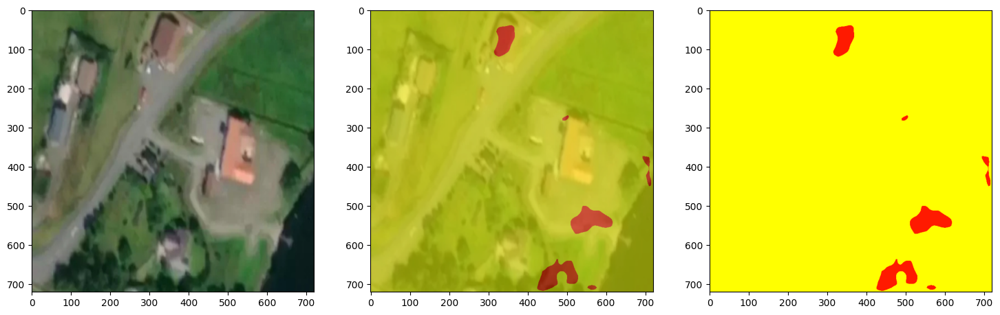

Saved image 1 to ./saved_images/1.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step


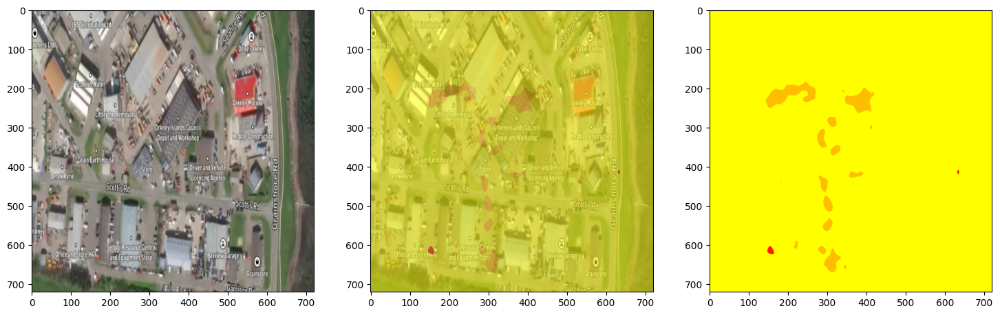

Saved image 2 to ./saved_images/2.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


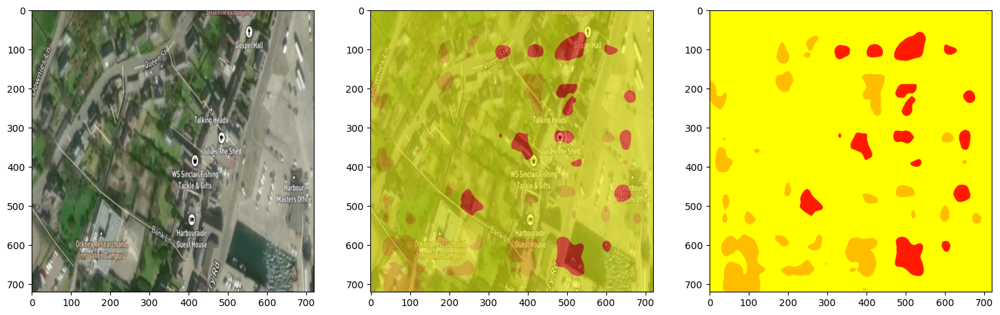

Saved image 3 to ./saved_images/3.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step


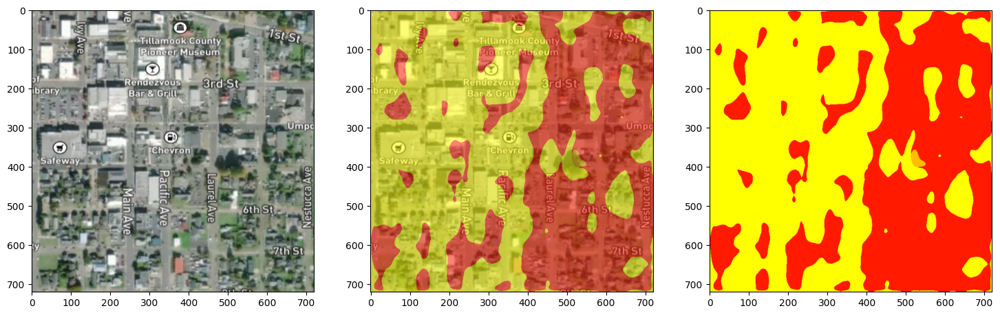

Saved image 4 to ./saved_images/4.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step


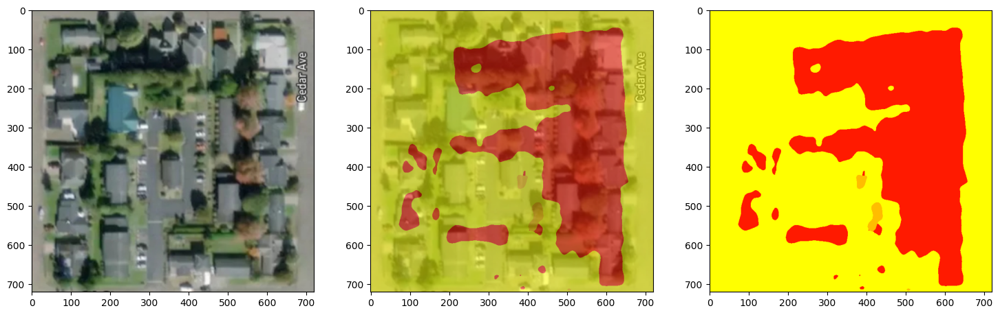

Saved image 5 to ./saved_images/5.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step


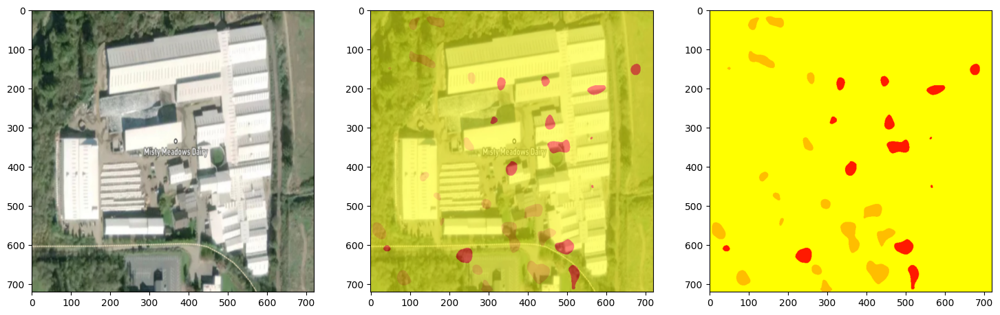

Saved image 6 to ./saved_images/6.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step


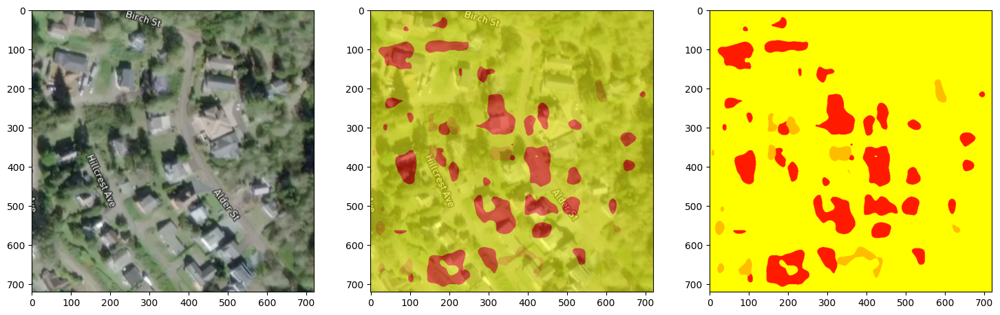

Saved image 7 to ./saved_images/7.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step


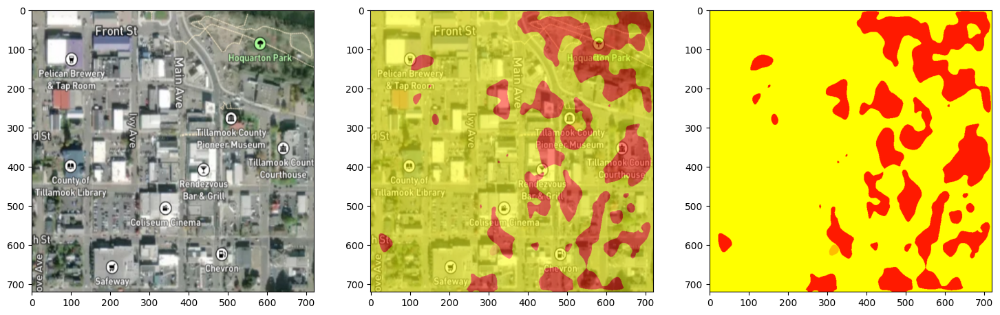

Saved image 8 to ./saved_images/8.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step


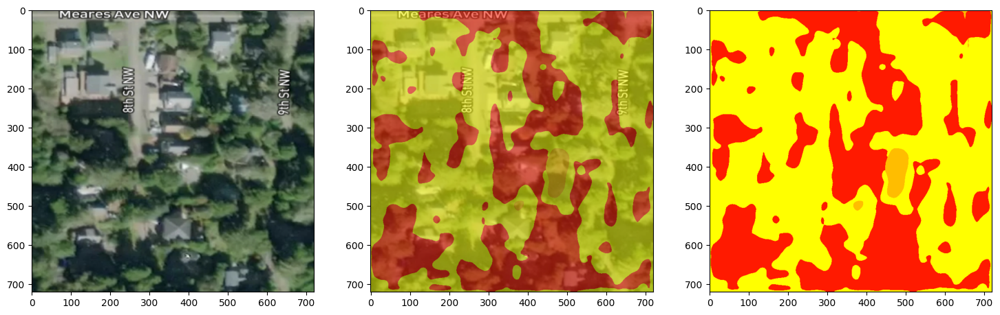

Saved image 9 to ./saved_images/9.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step


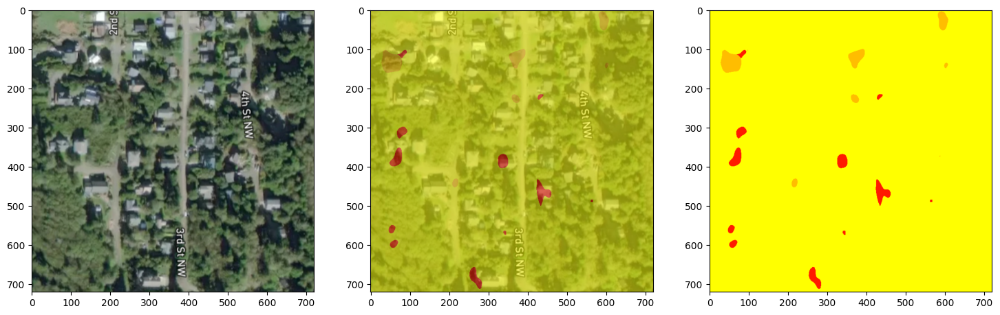

Saved image 10 to ./saved_images/10.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step


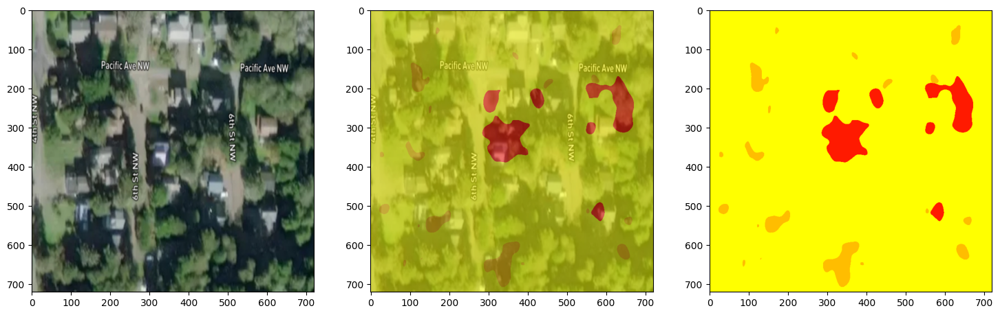

Saved image 11 to ./saved_images/11.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


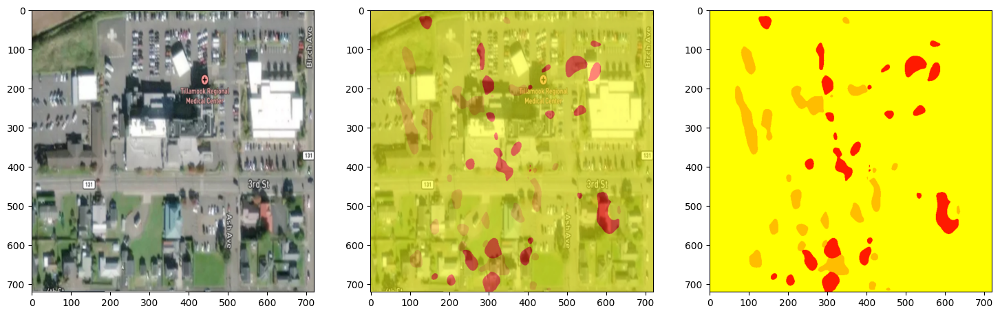

Saved image 12 to ./saved_images/12.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step


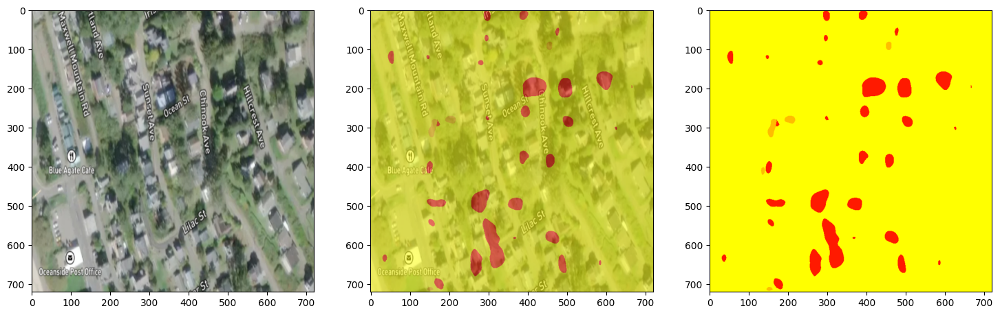

Saved image 13 to ./saved_images/13.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step


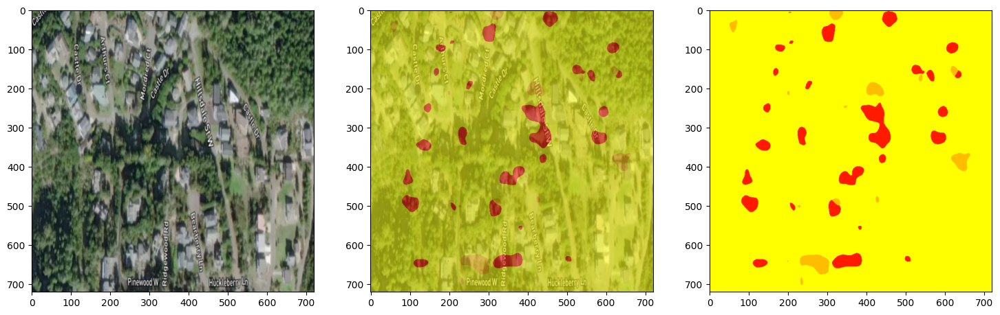

Saved image 14 to ./saved_images/14.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step


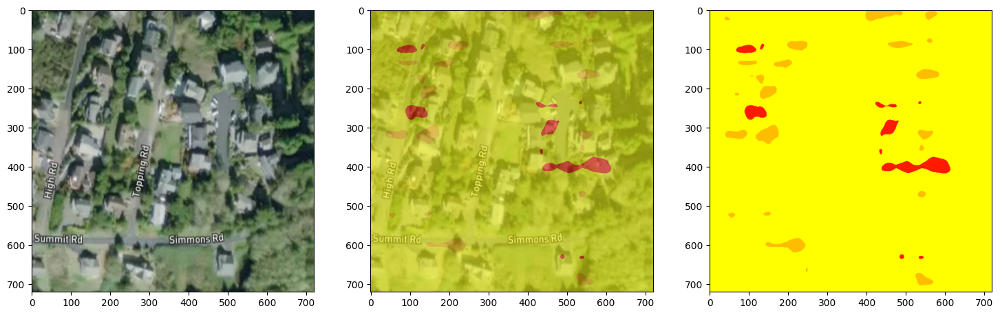

Saved image 15 to ./saved_images/15.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step


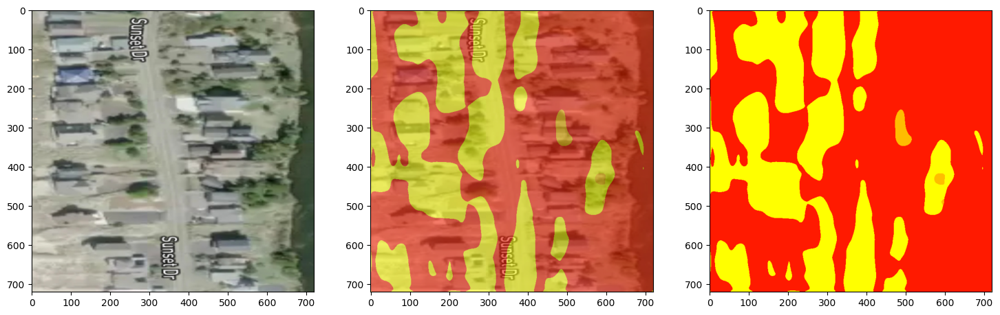

Saved image 16 to ./saved_images/16.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


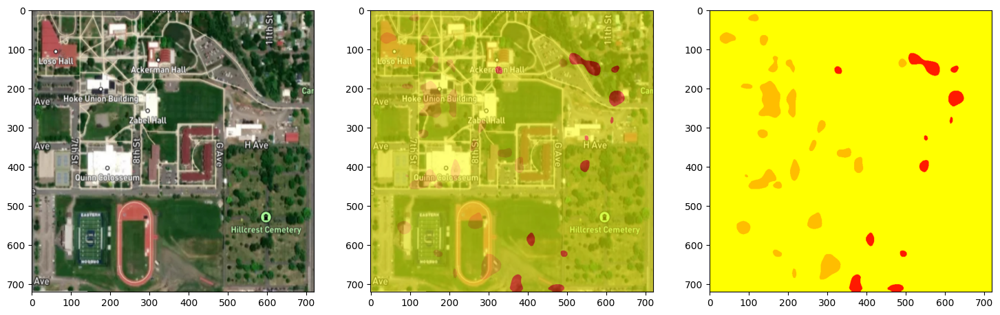

Saved image 17 to ./saved_images/17.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step


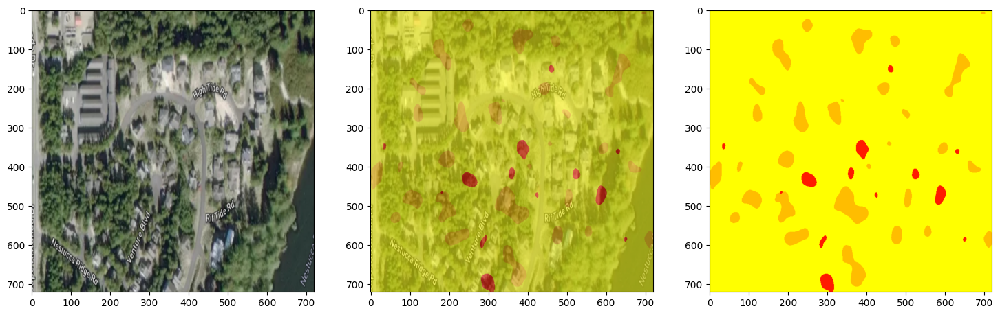

Saved image 18 to ./saved_images/18.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step


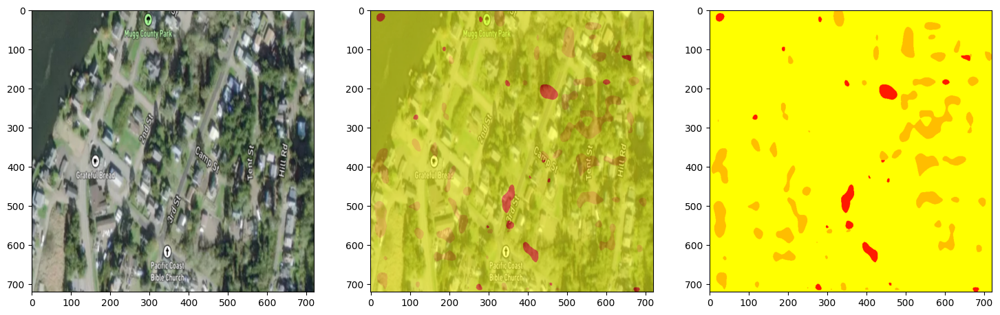

Saved image 19 to ./saved_images/19.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step


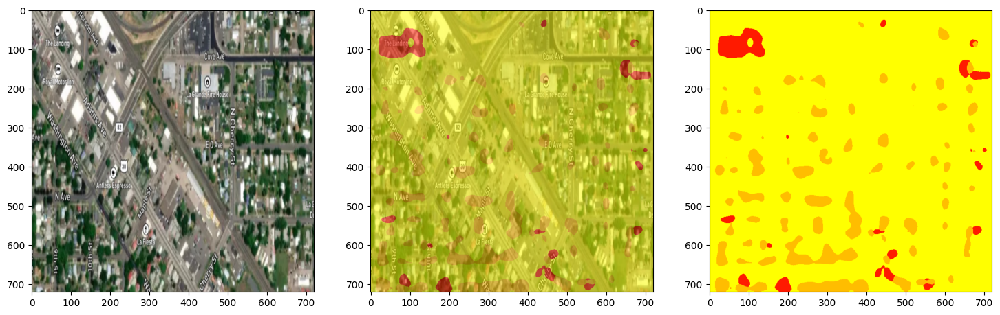

Saved image 20 to ./saved_images/20.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step


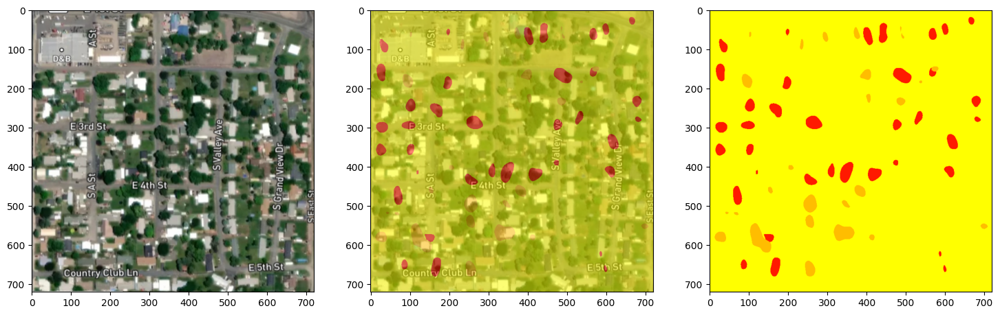

Saved image 21 to ./saved_images/21.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step


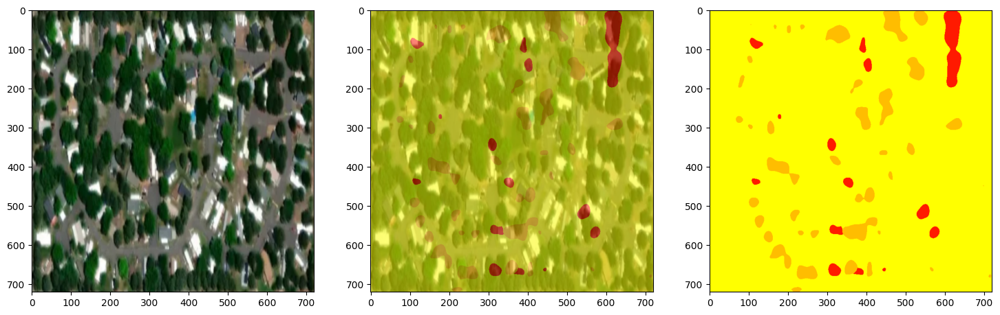

Saved image 22 to ./saved_images/22.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step


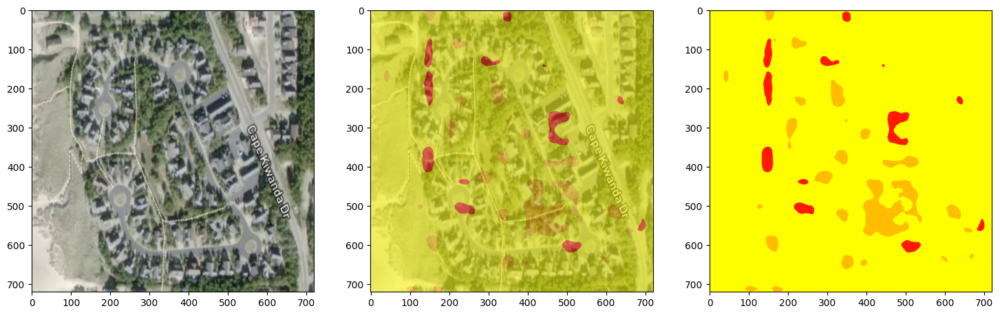

Saved image 23 to ./saved_images/23.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step


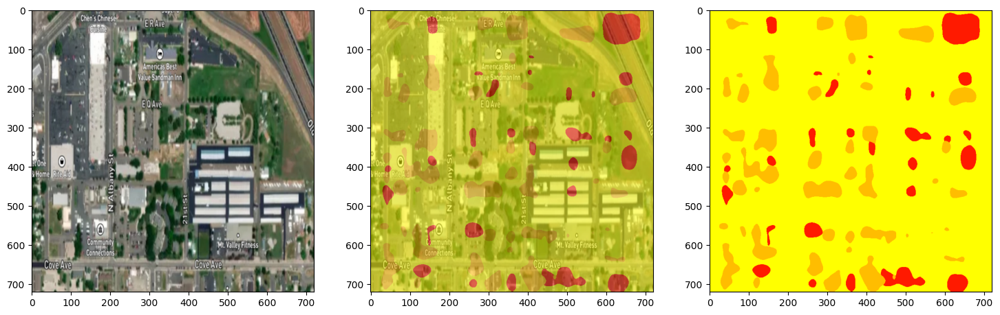

Saved image 24 to ./saved_images/24.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step


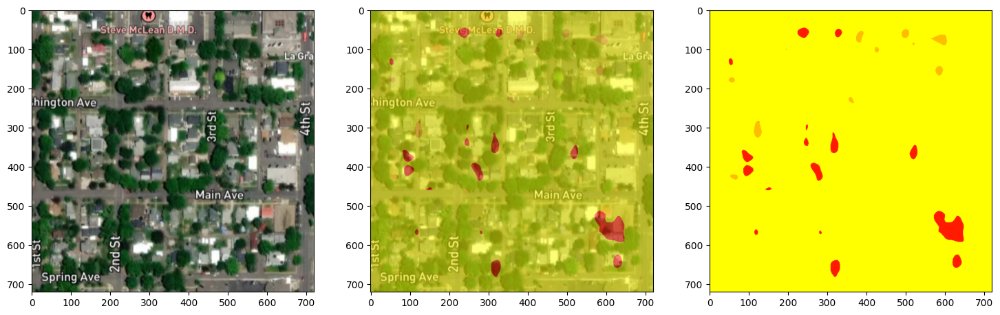

Saved image 25 to ./saved_images/25.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step


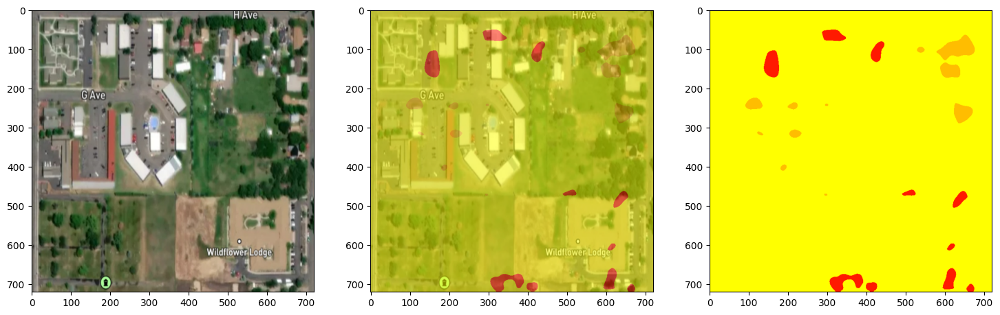

Saved image 26 to ./saved_images/26.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step


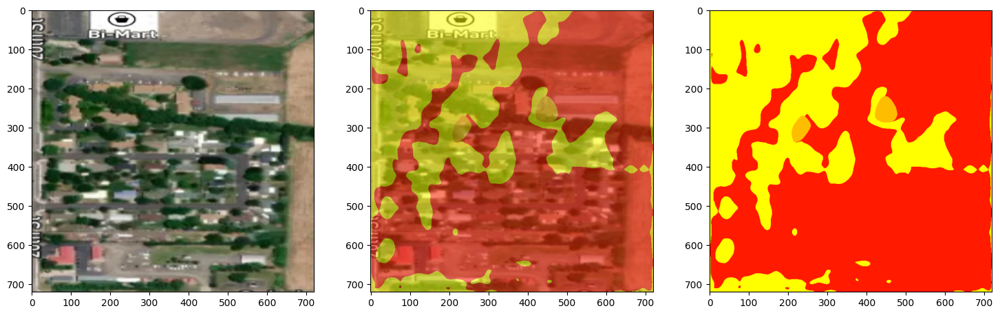

Saved image 27 to ./saved_images/27.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step


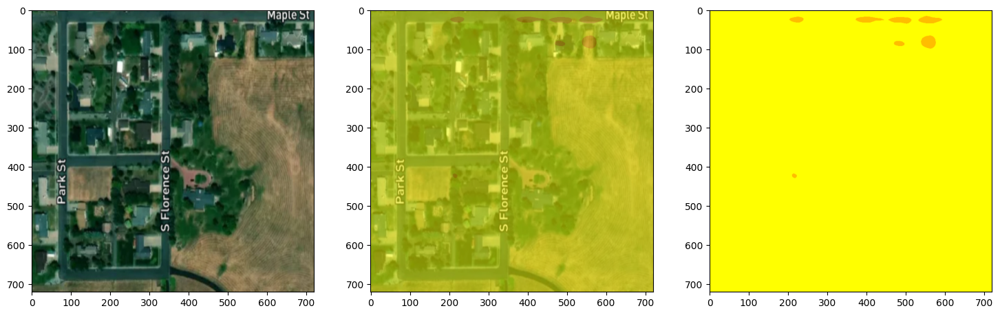

Saved image 28 to ./saved_images/28.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step


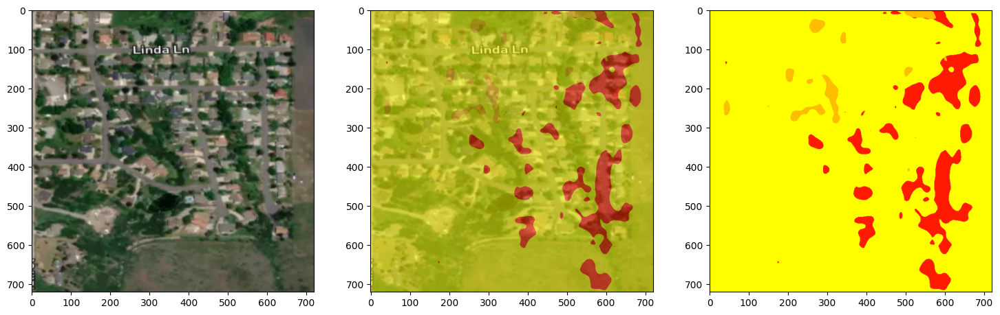

Saved image 29 to ./saved_images/29.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step


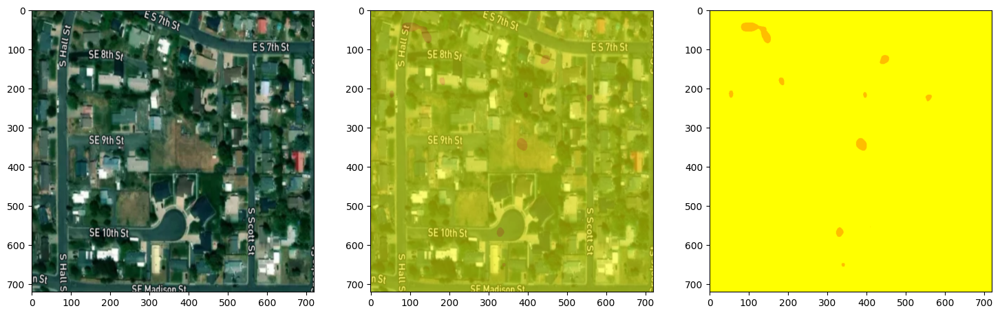

Saved image 30 to ./saved_images/30.jpg


In [ ]:
plot_predictions(train_images[:30], colormap, model=model)

In [ ]:
# Define a function to load the testing data
def load_testing_data(image_list, mask_list):
    image_paths = image_list[-40:]
    mask_paths = mask_list[-40:]
    dataset = tf_data.Dataset.from_tensor_slices((image_paths, mask_paths))
    dataset = dataset.map(load_data, num_parallel_calls=tf_data.AUTOTUNE)
    dataset = dataset.batch(BATCH_SIZE, drop_remainder=True)
    return dataset

# Load the trained model
saved_model_path = "/content/drive/MyDrive/Dataset/dummy.keras"
loaded_model = keras.models.load_model(saved_model_path)

# Evaluate the model on the testing dataset
testing_dataset = load_testing_data(train_images, train_masks)
testing_loss, testing_accuracy = loaded_model.evaluate(testing_dataset)

print("Testing Loss:", testing_loss)
print("Testing Accuracy:", testing_accuracy)



10/10 ━━━━━━━━━━━━━━━━━━━━ 9s 361ms/step - accuracy: 0.8867 - loss: 0.3167
Testing Loss: 0.3552405834197998
Testing Accuracy: 0.8835617899894714
